<a href="https://colab.research.google.com/github/Jeremy26/tracking_course/blob/master/3_DeepSORT_v5_(1).ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Welcome to the Deep Tracking Project!

In this workshop, we are going to move to the Deep Learning side of tracking, and **add Deep Convolutional Feature Calculations to our project**!

![](https://encrypted-tbn0.gstatic.com/images?q=tbn:ANd9GcSBULsREB4qHX1pRPz70RBWucfbdMyN0KGAUg&usqp=CAU)

In [ ]:
!wget https://thinkautonomous-tracking.s3.eu-west-3.amazonaws.com/tracking_course.zip && unzip tracking_course.zip

## Imports

In [ ]:
import matplotlib.image as mpimg
import matplotlib.pyplot as plt
import copy
import glob
import pickle
import cv2
import re
import numpy as np

In [ ]:
import torch
import torchvision
import torchvision.datasets as dset
import torchvision.transforms as transforms
import torchvision.utils
from torch.utils.data import DataLoader,Dataset
from torch.autograd import Variable
import torch.nn as nn
from torch import optim
import torch.nn.functional as F

## Load & Visualize the Images

In [ ]:
def visualize_images(input_images):
    fig=plt.figure(figsize=(150,75))
    for i in range(len(input_images)):
        fig.add_subplot(1, len(input_images), i+1)
        plt.imshow(input_images[i])
    plt.show()

In [ ]:
#images_files = sorted(glob.glob("tracking_course/data/*.png"))
#Indexes to test on:
# 100 — Same number of detections
# 300 — 2 Lost Tracks
# 782 — 1 New Detection

# NVIDIA AI CHALLENGE
images_files = sorted(glob.glob("tracking_course/nvidia/*.jpg"), key=lambda x:float(re.findall("(\d+)",x)[0]))
images = []

index = 57
for img in images_files[index:index+2]:
    images.append(cv2.cvtColor(cv2.imread(img), cv2.COLOR_BGR2RGB))

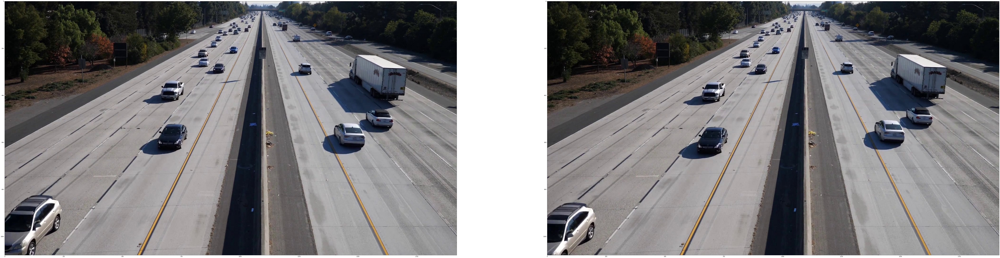

In [ ]:
visualize_images(images)

## 1) YOLOv5 — Object Detection

-- Just copy and paste the parts from the object detection workshop

In [ ]:
!pip install yolo5 # version 0.0.1 used at the moment of recording

In [ ]:
import yolov5
model = yolov5.load('tracking_course/yolov5s.pt')

/usr/local/lib/python3.7/dist-packages/torch/functional.py:445: UserWarning: torch.meshgrid: in an upcoming release, it will be required to pass the indexing argument. (Triggered internally at  ../aten/src/ATen/native/TensorShape.cpp:2157.)
  return _VF.meshgrid(tensors, **kwargs)  # type: ignore[attr-defined]


In [ ]:
model.conf = 0.5
model.iou = 0.4

In [ ]:
classesFile = "tracking_course/coco.names"
with open(classesFile,'rt') as f:
    classes = f.read().rstrip('\n').split('\n')

def id_to_color(idx):
    """
    Random function to convert an id to a color
    Do what you want here but keep numbers below 255
    """
    blue = idx*5 % 256
    green = idx*12 %256
    red = idx*23 %256
    return (red, green, blue)

def draw_boxes_v5(image, boxes, categories, mot_mode=False):
    h, w, _ = image.shape
    for i, box in enumerate(boxes):
        label = classes[int(categories[i])]
        color = id_to_color(i*10) if mot_mode==True else (255,0,0)
        cv2.rectangle(image, (int(box[0]), int(box[1])), (int(box[2]), int(box[3])), color, thickness=7)
        cv2.putText(image, str(label), (int(box[0]), int(box[1])), cv2.FONT_HERSHEY_SIMPLEX, 1, (255,255,255), thickness=3)
    return image

def inference(img):
    results = model(img)
    predictions = results.pred[0]
    boxes = predictions[:, :4].tolist()
    boxes_int = [[int(v) for v in box] for box in boxes]
    scores = predictions[:,4].tolist()
    categories = predictions[:,5].tolist()
    categories_int = [int(c) for c in categories]
    img_out = draw_boxes_v5(img, boxes_int, categories_int, mot_mode=True)
    return img_out, boxes_int, categories_int, scores

In [ ]:
yolo_images = []
yolo_boxes = []
yolo_categories = []
yolo_scores = []
pics = copy.deepcopy(images)

for img in pics:
    result, pred_bboxes, pred_categories, pred_scores = inference(img)
    yolo_boxes.append(pred_bboxes)
    yolo_images.append(result)
    yolo_categories.append(pred_categories)
    yolo_scores.append(pred_scores)

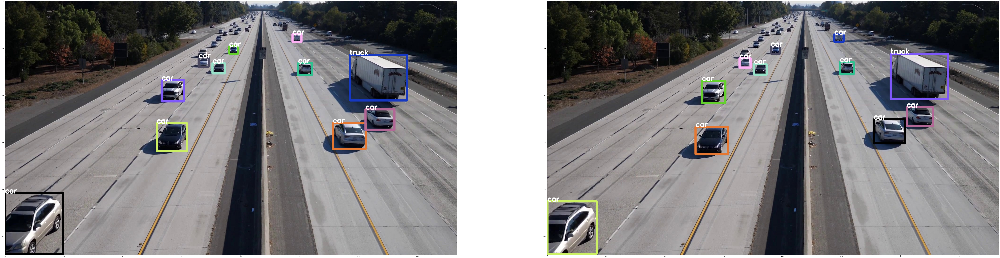

In [ ]:
visualize_images(yolo_images)

In [ ]:
print("Frame 1")
print(yolo_boxes[0])
print(yolo_categories[0])
print(yolo_scores[0])
print("Frame 2")
print(yolo_boxes[1])
print(yolo_categories[1])
print(yolo_scores[1])

Frame 1
[[0, 816, 247, 1074], [1392, 517, 1532, 628], [644, 519, 774, 636], [1531, 460, 1654, 546], [881, 263, 933, 307], [665, 336, 761, 426], [952, 192, 991, 223], [822, 241, 865, 279], [1245, 263, 1305, 314], [1464, 228, 1707, 422], [1221, 141, 1259, 172]]
[2, 2, 2, 2, 2, 2, 2, 2, 2, 7, 2]
[0.87255859375, 0.84765625, 0.83447265625, 0.82177734375, 0.75341796875, 0.7275390625, 0.673828125, 0.66162109375, 0.61181640625, 0.61083984375, 0.5087890625]
Frame 2
[[1386, 502, 1519, 603], [629, 534, 768, 651], [0, 851, 209, 1074], [1526, 451, 1638, 530], [877, 266, 931, 312], [1458, 223, 1701, 416], [656, 338, 756, 432], [949, 192, 988, 223], [1242, 258, 1301, 311], [1219, 141, 1258, 172], [816, 243, 863, 282]]
[2, 2, 2, 2, 2, 7, 2, 2, 2, 2, 2]
[0.86474609375, 0.83251953125, 0.8203125, 0.76708984375, 0.763671875, 0.70263671875, 0.67333984375, 0.64306640625, 0.5751953125, 0.564453125, 0.552734375]


## 2) Hungarian Algorithm with Deep Association Metrics

### 2.1 Load the Siamese Network

In [ ]:
!mv tracking_course/siamese_net.py .

In [ ]:
encoder = torch.load("tracking_course/model640.pt", map_location=torch.device('cpu'))
encoder = encoder.eval()

/usr/local/lib/python3.7/dist-packages/torch/serialization.py:671: SourceChangeWarning: source code of class 'siamese_net.SiameseNetwork' has changed. you can retrieve the original source code by accessing the object's source attribute or set `torch.nn.Module.dump_patches = True` and use the patch tool to revert the changes.
  warnings.warn(msg, SourceChangeWarning)
/usr/local/lib/python3.7/dist-packages/torch/serialization.py:671: SourceChangeWarning: source code of class 'torch.nn.modules.container.Sequential' has changed. you can retrieve the original source code by accessing the object's source attribute or set `torch.nn.Module.dump_patches = True` and use the patch tool to revert the changes.
  warnings.warn(msg, SourceChangeWarning)
/usr/local/lib/python3.7/dist-packages/torch/serialization.py:671: SourceChangeWarning: source code of class 'torch.nn.modules.conv.Conv2d' has changed. you can retrieve the original source code by accessing the object's source attribute or set `torch

### 2.2 Crop the obstacles

In [ ]:
def crop_frames(frame, boxes):
    try:
        transforms = torchvision.transforms.Compose([torchvision.transforms.ToPILImage(), torchvision.transforms.Resize((128,128)), torchvision.transforms.ToTensor()])
        crops = []
        crops_pytorch = []
        for box in boxes:
            crop = frame[int(box[1]):int(box[3]), int(box[0]):int(box[2])]
            crops.append(crop)
            crops_pytorch.append(transforms(crop))
        return crops, torch.stack(crops_pytorch)
    except:
        return [],[]

In [ ]:
from scipy.stats import multivariate_normal

def get_gaussian_mask():
	#128 is image size
	x, y = np.mgrid[0:1.0:128j, 0:1.0:128j]
	xy = np.column_stack([x.flat, y.flat])
	mu = np.array([0.5,0.5])
	sigma = np.array([0.22,0.22])
	covariance = np.diag(sigma**2)
	z = multivariate_normal.pdf(xy, mean=mu, cov=covariance)
	z = z.reshape(x.shape)

	z = z / z.max()
	z  = z.astype(np.float32)

	mask = torch.from_numpy(z)

	return mask
gaussian_mask = get_gaussian_mask()

#### Frame 1

In [ ]:
pics = copy.deepcopy(images)

In [ ]:
print(pics[0].shape)
h, w, _ = pics[0].shape

(1080, 1920, 3)


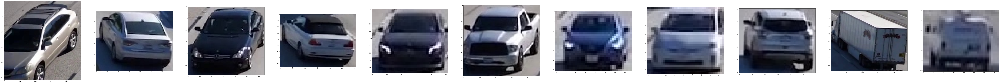

In [ ]:
crops_1, crops_pytorch_1 = crop_frames(pics[0], yolo_boxes[0])
crops_pytorch_1 = gaussian_mask * crops_pytorch_1
visualize_images(crops_1)

#### Frame 2

In [ ]:
print(pics[1].shape)
h, w, _ = pics[1].shape

(1080, 1920, 3)


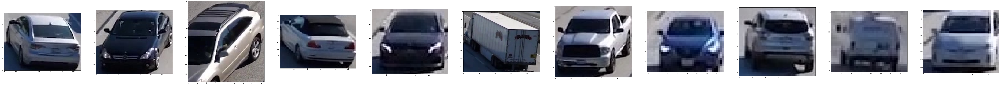

In [ ]:
crops_2, crops_pytorch_2 = crop_frames(pics[1], yolo_boxes[1])
crops_pytorch_2 = gaussian_mask * crops_pytorch_2
visualize_images(crops_2)

### 2.3 Cosine Distance

In [ ]:
def cosine_similarity(a, b, data_is_normalized=False):
    if not data_is_normalized:
        a = np.asarray(a) / np.linalg.norm(a, axis=1, keepdims=True)
        b = np.asarray(b) / np.linalg.norm(b, axis=1, keepdims=True)
    return np.dot(a, b.T)

In [ ]:
## EXAMPLE
a = np.array([[0,0,1]])
b = np.array([[0,1,1]])
c = np.array([[1,1,0]])

print(cosine_similarity(a,b))
print(cosine_similarity(a,c))
print(cosine_similarity(a,a))

[[    0.70711]]
[[          0]]
[[          1]]


In [ ]:
def get_features(encoder, processed_crops):
    features = []
    if len(processed_crops)>0:
        features = encoder.forward_once(processed_crops)
        features = features.detach().cpu().numpy()
        if len(features.shape)==1:
            features = np.expand_dims(features,0)
    return features  

In [ ]:
features_1 = get_features(encoder, crops_pytorch_1)
features_2 = get_features(encoder, crops_pytorch_2) 

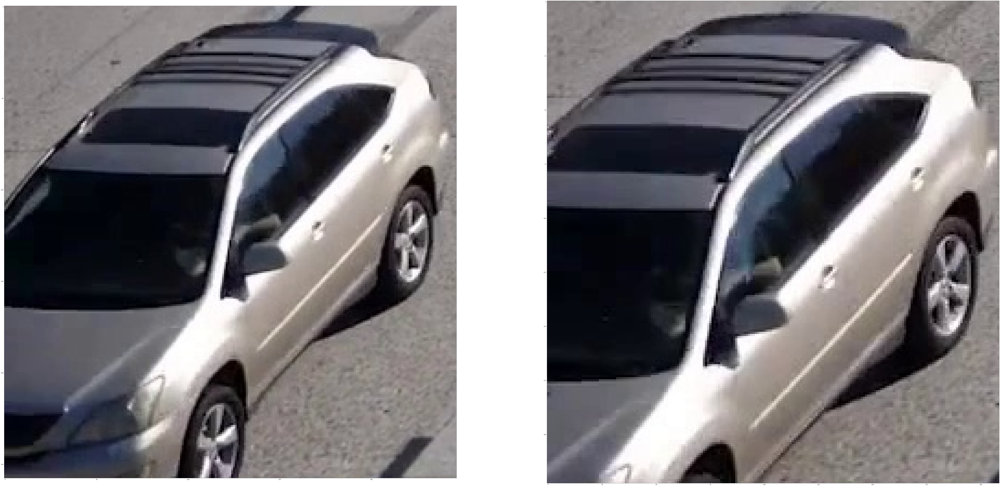

In [ ]:
visualize_images([crops_1[0], crops_2[2]])

In [ ]:
for a, box1 in enumerate(yolo_boxes[0]):
    print("--")
    for b, box2 in enumerate(yolo_boxes[1]):
        dist = cosine_similarity(features_1[a].reshape(1,1024), features_2[b].reshape(1,1024))
        print("Box ", a , ": ", str(box1),"Box ", b, ": ", str(box2), "Distance: ", str(dist[0][0]))

--
Box  0 :  [0, 816, 247, 1074] Box  0 :  [1386, 502, 1519, 603] Distance:  0.12253244
Box  0 :  [0, 816, 247, 1074] Box  1 :  [629, 534, 768, 651] Distance:  0.12250904
Box  0 :  [0, 816, 247, 1074] Box  2 :  [0, 851, 209, 1074] Distance:  0.31986222
Box  0 :  [0, 816, 247, 1074] Box  3 :  [1526, 451, 1638, 530] Distance:  0.0660033
Box  0 :  [0, 816, 247, 1074] Box  4 :  [877, 266, 931, 312] Distance:  0.08417874
Box  0 :  [0, 816, 247, 1074] Box  5 :  [1458, 223, 1701, 416] Distance:  0.33268714
Box  0 :  [0, 816, 247, 1074] Box  6 :  [656, 338, 756, 432] Distance:  0.04607799
Box  0 :  [0, 816, 247, 1074] Box  7 :  [949, 192, 988, 223] Distance:  0.14239135
Box  0 :  [0, 816, 247, 1074] Box  8 :  [1242, 258, 1301, 311] Distance:  0.3326804
Box  0 :  [0, 816, 247, 1074] Box  9 :  [1219, 141, 1258, 172] Distance:  0.18392527
Box  0 :  [0, 816, 247, 1074] Box  10 :  [816, 243, 863, 282] Distance:  0.04726727
--
Box  1 :  [1392, 517, 1532, 628] Box  0 :  [1386, 502, 1519, 603] Distanc

### 2.4 Adding the other costs

In [ ]:
def box_iou(box1, box2, w = 1280, h=360):
    xA = max(box1[0], box2[0])
    yA = max(box1[1], box2[1])
    xB = min(box1[2], box2[2])
    yB = min(box1[3], box2[3])

    inter_area = max(0, xB - xA + 1) * max(0, yB - yA + 1) #abs((xi2 - xi1)*(yi2 - yi1))
    # Calculate the Union area by using Formula: Union(A,B) = A + B - Inter(A,B)
    box1_area = (box1[2] - box1[0] + 1) * (box1[3] - box1[1] + 1) #abs((box1[3] - box1[1])*(box1[2]- box1[0]))
    box2_area = (box2[2] - box2[0] + 1) * (box2[3] - box2[1] + 1) #abs((box2[3] - box2[1])*(box2[2]- box2[0]))
    union_area = (box1_area + box2_area) - inter_area
    # compute the IoU
    iou = inter_area/float(union_area)
    return iou

In [ ]:
def check_division_by_0(value, epsilon=0.01):
    if value < epsilon:
        value = epsilon
    return value

In [ ]:
def sanchez_matilla(box1, box2, w = 1280, h=360):
    Q_dist = sqrt(pow(w,2)+pow(h,2)) # First real-life Pythagore use in your life
    Q_shape = w*h
    distance_term = Q_dist/check_division_by_0(sqrt(pow(box1[0] - box2[0], 2)+pow(box1[1] -box2[1],2)))
    shape_term = Q_shape/check_division_by_0(sqrt(pow(box1[2] - box2[2], 2)+pow(box1[3] - box2[3],2)))
    linear_cost = distance_term*shape_term
    return linear_cost

In [ ]:
from math import sqrt, exp

def yu(box1, box2):
    w1 = 0.5
    w2 = 1.5
    a= (box1[0] - box2[0])/check_division_by_0(box1[2])
    a_2 = pow(a,2)
    b = (box1[1] - box2[1])/check_division_by_0(box1[3])
    b_2 = pow(b,2)
    ab = (a_2+b_2)*w1*(-1)
    c = abs(box1[3] - box2[3])/(box1[3]+box2[3])
    d = abs(box1[2]-box2[2])/(box1[2]+box2[2])
    cd = (c+d)*w2*(-1)
    exponential_cost = exp(ab)*exp(cd)
    return exponential_cost

### 2.5. Main Function

In [ ]:
def total_cost(old_box, new_box, old_features, new_features, iou_thresh = 0.3, linear_thresh = 10000, exp_thresh = 0.5, feat_thresh = 0.2):
    iou_cost = box_iou(old_box, new_box)
    linear_cost = sanchez_matilla(old_box, new_box, w= 1920, h=1080)
    exponential_cost = yu(old_box, new_box)
    feature_cost = cosine_similarity(old_features, new_features)[0][0]

    if (iou_cost >= iou_thresh and linear_cost >= linear_thresh and exponential_cost>=exp_thresh and feature_cost >= feat_thresh):
        return iou_cost

    else:
        return 0

#### Association

In [ ]:
from scipy.optimize import linear_sum_assignment

def associate(old_boxes, new_boxes, old_features, new_features):
    """
    old_boxes will represent the former bounding boxes (at time 0)
    new_boxes will represent the new bounding boxes (at time 1)
    Function goal: Define a Hungarian Matrix with IOU as a metric and return, for each box, an id
    """
    if len(old_boxes)==0 and len(new_boxes)==0:
        return [], [], []
    elif(len(old_boxes)==0):
        return [], [i for i in range(len(new_boxes))], [] #Weird trick
    elif(len(new_boxes)==0):
        return [], [], [i for i in range(len(old_boxes))]# Weird trick 
        
    # Define a new IOU Matrix nxm with old and new boxes
    iou_matrix = np.zeros((len(old_boxes),len(new_boxes)),dtype=np.float32)
    
    # Go through boxes and store the IOU value for each box 
    # You can also use the more challenging cost but still use IOU as a reference for convenience (use as a filter only)
    for i,old_box in enumerate(old_boxes):
        for j,new_box in enumerate(new_boxes):
            iou_matrix[i][j] = total_cost(old_box, new_box, old_features[i].reshape(1,1024), new_features[j].reshape(1,1024))

    #print(iou_matrix)
    # Call for the Hungarian Algorithm
    hungarian_row, hungarian_col = linear_sum_assignment(-iou_matrix)
    hungarian_matrix = np.array(list(zip(hungarian_row, hungarian_col)))

    # Create new unmatched lists for old and new boxes
    matches, unmatched_detections, unmatched_trackers = [], [], []

    #print(hungarian_matrix)
    
    # Go through old boxes, if no matched detection, add it to the unmatched_old_boxes
    for t,trk in enumerate(old_boxes):
	    if(t not in hungarian_matrix[:,0]):
		    unmatched_trackers.append(t)
    
    # Go through new boxes, if no matched tracking, add it to the unmatched_new_boxes
    for d, det in enumerate(new_boxes):
        if(d not in hungarian_matrix[:,1]):
                unmatched_detections.append(d)
    
    # Go through the Hungarian Matrix, if matched element has IOU < threshold (0.3), add it to the unmatched 
    for h in hungarian_matrix:
        if(iou_matrix[h[0],h[1]]<0.3):
            unmatched_trackers.append(h[0]) # Return INDICES directly
            unmatched_detections.append(h[1]) # Return INDICES directly
        else:
            matches.append(h.reshape(1,2))
    
    if(len(matches)==0):
        matches = np.empty((0,2),dtype=int)
    else:
        matches = np.concatenate(matches,axis=0)
    

    return matches, unmatched_detections,unmatched_trackers

In [ ]:
matches, unmatched_detections, unmatched_trackers = associate(yolo_boxes[0], yolo_boxes[1], features_1, features_2)

In [ ]:
print(yolo_boxes[0])
print(yolo_boxes[1])
print(matches)

[[0, 816, 247, 1074], [1392, 517, 1532, 628], [644, 519, 774, 636], [1531, 460, 1654, 546], [881, 263, 933, 307], [665, 336, 761, 426], [952, 192, 991, 223], [822, 241, 865, 279], [1245, 263, 1305, 314], [1464, 228, 1707, 422], [1221, 141, 1259, 172]]
[[1386, 502, 1519, 603], [629, 534, 768, 651], [0, 851, 209, 1074], [1526, 451, 1638, 530], [877, 266, 931, 312], [1458, 223, 1701, 416], [656, 338, 756, 432], [949, 192, 988, 223], [1242, 258, 1301, 311], [1219, 141, 1258, 172], [816, 243, 863, 282]]
[[ 0  2]
 [ 1  0]
 [ 2  1]
 [ 3  3]
 [ 5  6]
 [ 7 10]
 [ 8  8]
 [ 9  5]
 [10  9]]


In [ ]:
print(unmatched_detections)

[7, 4]


In [ ]:
print(unmatched_trackers)

[4, 6]


## 3) Hungarian Tracking Loop

In [ ]:
MIN_HIT_STREAK = 1
MAX_UNMATCHED_AGE = 1

In [ ]:
class Obstacle():
    def __init__(self, idx, box, features=None,  age=1, unmatched_age=0):
        """
        Init function. The obstacle must have an id and a box.
        """
        self.idx = idx
        self.box = box
        self.features = features
        self.age = age
        self.unmatched_age = unmatched_age

In [ ]:
def main(input_image):
    global stored_obstacles
    global idx

    # 1 — Run Obstacle Detection & Convert the Boxes
    final_image = copy.deepcopy(input_image)
    h, w, _ = final_image.shape

    _, out_boxes, _, _ = inference(input_image)
    crops, crops_pytorch = crop_frames(final_image, out_boxes)
    features = get_features(encoder, crops_pytorch)
    
    print("----> New Detections: ", out_boxes)
    # Define the list we'll return:
    new_obstacles = []

    old_obstacles = [obs.box for obs in stored_obstacles] # Simply get the boxes
    old_features = [obs.features for obs in stored_obstacles]
    
    matches, unmatched_detections, unmatched_tracks = associate(old_obstacles, out_boxes, old_features, features)

    # Matching
    for match in matches:
        obs = Obstacle(stored_obstacles[match[0]].idx, out_boxes[match[1]], features[match[1]], stored_obstacles[match[0]].age +1)
        new_obstacles.append(obs)
        print("Obstacle ", obs.idx, " with box: ", obs.box, "has been matched with obstacle ", stored_obstacles[match[0]].box, "and now has age: ", obs.age)
    
    # New (Unmatched) Detections
    for d in unmatched_detections:
        obs = Obstacle(idx, out_boxes[d], features[d])
        new_obstacles.append(obs)
        idx+=1
        print("Obstacle ", obs.idx, " has been detected for the first time: ", obs.box)

    # Unmatched Tracks
    for t in unmatched_tracks:
        i = old_obstacles.index(stored_obstacles[t].box)
        print("Old Obstacles tracked: ", stored_obstacles[i].box)
        if i is not None:
            obs = stored_obstacles[i]
            obs.unmatched_age +=1
            new_obstacles.append(obs)
            print("Obstacle ", obs.idx, "is a long term obstacle unmatched ", obs.unmatched_age, "times.")

    # Draw the Boxes
    for i, obs in enumerate(new_obstacles):
        if obs.unmatched_age > MAX_UNMATCHED_AGE:
            new_obstacles.remove(obs)

        if obs.age >= MIN_HIT_STREAK:
            left, top, right, bottom = obs.box
            cv2.rectangle(final_image, (left, top), (right, bottom), id_to_color(obs.idx*10), thickness=7)
            final_image = cv2.putText(final_image, str(obs.idx),(left - 10,top - 10),cv2.FONT_HERSHEY_SIMPLEX, 1,id_to_color(obs.idx*10),thickness=4)

    stored_obstacles = new_obstacles

    return final_image, stored_obstacles

----> New Detections:  [[0, 816, 247, 1074], [1392, 517, 1532, 628], [644, 519, 774, 636], [1531, 460, 1654, 546], [881, 263, 933, 307], [665, 336, 761, 426], [952, 192, 991, 223], [822, 241, 865, 279], [1245, 263, 1305, 314], [1464, 228, 1707, 422], [1221, 141, 1259, 172]]
Obstacle  0  has been detected for the first time:  [0, 816, 247, 1074]
Obstacle  1  has been detected for the first time:  [1392, 517, 1532, 628]
Obstacle  2  has been detected for the first time:  [644, 519, 774, 636]
Obstacle  3  has been detected for the first time:  [1531, 460, 1654, 546]
Obstacle  4  has been detected for the first time:  [881, 263, 933, 307]
Obstacle  5  has been detected for the first time:  [665, 336, 761, 426]
Obstacle  6  has been detected for the first time:  [952, 192, 991, 223]
Obstacle  7  has been detected for the first time:  [822, 241, 865, 279]
Obstacle  8  has been detected for the first time:  [1245, 263, 1305, 314]
Obstacle  9  has been detected for the first time:  [1464, 228,

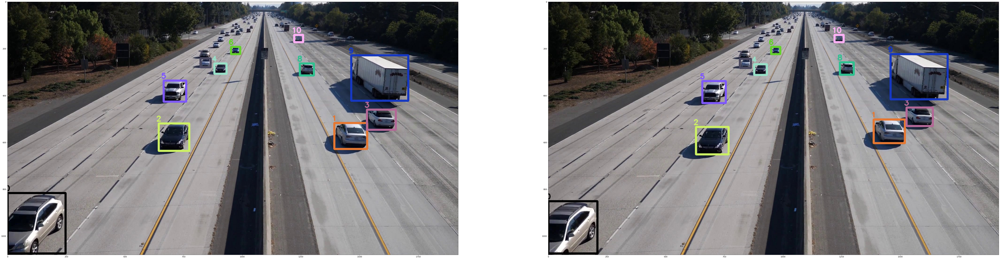

In [ ]:
### Call the main loop

fig=plt.figure(figsize=(100,100))
out_imgs = []
idx = 0
stored_obstacles = []

for i in range(len(images)):
    out_img, stored_obstacles = main(images[i])
    out_imgs.append(out_img)
    fig.add_subplot(1, len(images), i+1)
    plt.imshow(out_imgs[i])

plt.show()

Test Again with more images

In [ ]:
images = []
index = 34

# 100 — Same number of detections
# 300 — 2 Lost Tracks
# 782 — 1 New Detection
# 654 — Edge Case

for img in images_files[index-2:index+10]:
    images.append(cv2.cvtColor(cv2.imread(img), cv2.COLOR_BGR2RGB))

----> New Detections:  [[502, 663, 676, 831], [546, 431, 665, 534], [829, 323, 901, 384], [786, 250, 850, 310], [932, 202, 977, 239], [974, 162, 1008, 187], [1618, 304, 1920, 844], [1331, 385, 1424, 467]]
Obstacle  0  has been detected for the first time:  [502, 663, 676, 831]
Obstacle  1  has been detected for the first time:  [546, 431, 665, 534]
Obstacle  2  has been detected for the first time:  [829, 323, 901, 384]
Obstacle  3  has been detected for the first time:  [786, 250, 850, 310]
Obstacle  4  has been detected for the first time:  [932, 202, 977, 239]
Obstacle  5  has been detected for the first time:  [974, 162, 1008, 187]
Obstacle  6  has been detected for the first time:  [1618, 304, 1920, 844]
Obstacle  7  has been detected for the first time:  [1331, 385, 1424, 467]
----> New Detections:  [[478, 682, 661, 859], [530, 438, 654, 549], [783, 255, 849, 313], [970, 163, 1008, 188], [827, 329, 896, 391], [931, 204, 975, 242], [1326, 378, 1418, 460], [1609, 304, 1920, 798]]
O

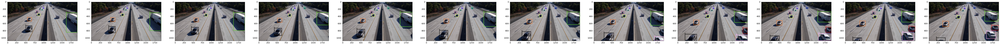

In [ ]:
### Call the main loop
idx = 0
stored_obstacles = []
fig=plt.figure(figsize=(100,100))
pics = copy.deepcopy(images)
out_imgs = []

for i in range(len(pics)):
    out_img, stored_obstacles = main(pics[i])
    out_imgs.append(out_img)
    fig.add_subplot(1, len(pics), i+1)
    plt.imshow(out_imgs[i])

plt.show()

# Video


Now is the time to run on a video. 

In [ ]:
import glob 
from tqdm import tqdm

idx = 0
stored_obstacles = []

#video_images = sorted(glob.glob("tracking_course/data/*.png")) #kitti
video_images = images_files #nvidia
result_video = []

for img in tqdm(video_images):
    out_img, stored_obstacles = main(cv2.cvtColor(cv2.imread(img), cv2.COLOR_BGR2RGB))
    if out_img is not None:
        result_video.append(out_img)

  2%|▏         | 2/90 [00:00<00:07, 11.26it/s]

----> New Detections:  [[587, 581, 742, 717], [830, 324, 891, 394], [914, 223, 965, 263], [868, 192, 913, 232], [768, 270, 828, 332], [1558, 171, 1603, 197], [1452, 144, 1485, 167]]
Obstacle  0  has been detected for the first time:  [587, 581, 742, 717]
Obstacle  1  has been detected for the first time:  [830, 324, 891, 394]
Obstacle  2  has been detected for the first time:  [914, 223, 965, 263]
Obstacle  3  has been detected for the first time:  [868, 192, 913, 232]
Obstacle  4  has been detected for the first time:  [768, 270, 828, 332]
Obstacle  5  has been detected for the first time:  [1558, 171, 1603, 197]
Obstacle  6  has been detected for the first time:  [1452, 144, 1485, 167]
----> New Detections:  [[569, 593, 732, 743], [828, 333, 888, 397], [910, 226, 963, 267], [1554, 173, 1599, 195], [867, 193, 911, 235]]
Obstacle  0  with box:  [569, 593, 732, 743] has been matched with obstacle  [587, 581, 742, 717] and now has age:  2
Obstacle  1  with box:  [828, 333, 888, 397] has 

  4%|▍         | 4/90 [00:00<00:08, 10.56it/s]

----> New Detections:  [[534, 633, 706, 790], [812, 339, 884, 410], [909, 232, 960, 269], [1549, 174, 1591, 194], [754, 281, 816, 344], [1687, 936, 1918, 1076], [863, 195, 908, 238]]
Obstacle  0  with box:  [534, 633, 706, 790] has been matched with obstacle  [553, 613, 720, 765] and now has age:  4
Obstacle  1  with box:  [812, 339, 884, 410] has been matched with obstacle  [821, 336, 884, 404] and now has age:  4
Obstacle  2  with box:  [909, 232, 960, 269] has been matched with obstacle  [910, 229, 961, 267] and now has age:  4
Obstacle  3  with box:  [863, 195, 908, 238] has been matched with obstacle  [863, 195, 912, 236] and now has age:  4
Obstacle  5  with box:  [1549, 174, 1591, 194] has been matched with obstacle  [1551, 174, 1596, 196] and now has age:  4
Obstacle  4  with box:  [754, 281, 816, 344] has been matched with obstacle  [756, 278, 819, 342] and now has age:  3
Obstacle  7  has been detected for the first time:  [1687, 936, 1918, 1076]
----> New Detections:  [[516,

  9%|▉         | 8/90 [00:00<00:07, 10.48it/s]

----> New Detections:  [[466, 698, 666, 882], [1615, 819, 1876, 1035], [800, 356, 875, 431], [735, 292, 807, 358], [907, 238, 954, 277], [1540, 168, 1585, 192]]
Obstacle  0  with box:  [466, 698, 666, 882] has been matched with obstacle  [489, 676, 681, 853] and now has age:  7
Obstacle  1  with box:  [800, 356, 875, 431] has been matched with obstacle  [804, 352, 873, 421] and now has age:  7
Obstacle  2  with box:  [907, 238, 954, 277] has been matched with obstacle  [909, 235, 954, 274] and now has age:  7
Obstacle  7  with box:  [1615, 819, 1876, 1035] has been matched with obstacle  [1584, 858, 1920, 1073] and now has age:  4
Obstacle  4  with box:  [735, 292, 807, 358] has been matched with obstacle  [748, 282, 811, 347] and now has age:  5
Obstacle  8  has been detected for the first time:  [1540, 168, 1585, 192]
Old Obstacles tracked:  [1545, 171, 1587, 193]
Obstacle  5 is a long term obstacle unmatched  1 times.
Old Obstacles tracked:  [860, 197, 906, 240]
Obstacle  3 is a lon

 11%|█         | 10/90 [00:00<00:07, 10.19it/s]

----> New Detections:  [[1554, 724, 1770, 900], [381, 776, 612, 1007], [780, 376, 859, 457], [724, 306, 794, 373], [896, 246, 951, 287], [1535, 167, 1581, 191], [961, 172, 999, 201], [911, 168, 944, 195], [852, 206, 897, 249]]
Obstacle  0  with box:  [381, 776, 612, 1007] has been matched with obstacle  [415, 747, 633, 960] and now has age:  10
Obstacle  1  with box:  [780, 376, 859, 457] has been matched with obstacle  [787, 369, 862, 449] and now has age:  10
Obstacle  2  with box:  [896, 246, 951, 287] has been matched with obstacle  [902, 243, 951, 283] and now has age:  10
Obstacle  7  with box:  [1554, 724, 1770, 900] has been matched with obstacle  [1575, 757, 1800, 939] and now has age:  7
Obstacle  4  with box:  [724, 306, 794, 373] has been matched with obstacle  [731, 302, 799, 367] and now has age:  8
Obstacle  11  with box:  [852, 206, 897, 249] has been matched with obstacle  [853, 204, 900, 248] and now has age:  2
Obstacle  9  with box:  [961, 172, 999, 201] has been ma

 13%|█▎        | 12/90 [00:01<00:07, 10.08it/s]

----> New Detections:  [[1521, 673, 1716, 831], [303, 843, 571, 1075], [767, 390, 851, 476], [714, 312, 789, 382], [846, 207, 895, 254], [896, 250, 945, 294]]
Obstacle  0  with box:  [303, 843, 571, 1075] has been matched with obstacle  [342, 807, 591, 1061] and now has age:  12
Obstacle  1  with box:  [767, 390, 851, 476] has been matched with obstacle  [776, 386, 852, 465] and now has age:  12
Obstacle  2  with box:  [896, 250, 945, 294] has been matched with obstacle  [894, 247, 950, 291] and now has age:  12
Obstacle  7  with box:  [1521, 673, 1716, 831] has been matched with obstacle  [1536, 698, 1740, 863] and now has age:  9
Obstacle  4  with box:  [714, 312, 789, 382] has been matched with obstacle  [720, 310, 793, 373] and now has age:  10
Obstacle  11  with box:  [846, 207, 895, 254] has been matched with obstacle  [848, 207, 894, 253] and now has age:  4
Old Obstacles tracked:  [963, 173, 998, 203]
Obstacle  9 is a long term obstacle unmatched  1 times.
Old Obstacles tracked

 18%|█▊        | 16/90 [00:01<00:07, 10.26it/s]

Obstacle  0  with box:  [269, 924, 519, 1078] has been matched with obstacle  [199, 879, 546, 1078] and now has age:  14
Obstacle  1  with box:  [754, 408, 838, 495] has been matched with obstacle  [760, 399, 844, 486] and now has age:  14
Obstacle  2  with box:  [891, 257, 942, 300] has been matched with obstacle  [895, 253, 943, 296] and now has age:  14
Obstacle  7  with box:  [1493, 626, 1665, 773] has been matched with obstacle  [1503, 649, 1689, 800] and now has age:  11
Obstacle  4  with box:  [704, 321, 781, 392] has been matched with obstacle  [709, 316, 784, 389] and now has age:  12
Obstacle  11  with box:  [842, 211, 890, 258] has been matched with obstacle  [844, 210, 892, 257] and now has age:  6
Obstacle  15  has been detected for the first time:  [958, 178, 993, 206]
Old Obstacles tracked:  [1800, 580, 1920, 984]
Obstacle  14 is a long term obstacle unmatched  1 times.
Old Obstacles tracked:  [1533, 165, 1578, 190]
Obstacle  13 is a long term obstacle unmatched  3 times

 20%|██        | 18/90 [00:01<00:07, 10.22it/s]

----> New Detections:  [[1452, 569, 1608, 700], [729, 435, 824, 527], [882, 265, 936, 312], [834, 217, 886, 267], [684, 333, 766, 412], [985, 146, 1018, 172], [1821, 447, 1920, 676], [1272, 180, 1316, 226]]
Obstacle  1  with box:  [729, 435, 824, 527] has been matched with obstacle  [738, 424, 827, 517] and now has age:  17
Obstacle  2  with box:  [882, 265, 936, 312] has been matched with obstacle  [884, 262, 936, 307] and now has age:  17
Obstacle  7  with box:  [1452, 569, 1608, 700] has been matched with obstacle  [1464, 586, 1629, 722] and now has age:  14
Obstacle  4  with box:  [684, 333, 766, 412] has been matched with obstacle  [689, 331, 769, 405] and now has age:  15
Obstacle  11  with box:  [834, 217, 886, 267] has been matched with obstacle  [838, 216, 888, 263] and now has age:  9
Obstacle  16  with box:  [985, 146, 1018, 172] has been matched with obstacle  [984, 145, 1018, 172] and now has age:  3
Obstacle  17  has been detected for the first time:  [1821, 447, 1920, 67

 22%|██▏       | 20/90 [00:01<00:06, 10.20it/s]

Obstacle  1  with box:  [714, 453, 807, 552] has been matched with obstacle  [722, 446, 818, 536] and now has age:  19
Obstacle  2  with box:  [876, 270, 933, 319] has been matched with obstacle  [880, 269, 936, 316] and now has age:  19
Obstacle  7  with box:  [1433, 536, 1575, 657] has been matched with obstacle  [1443, 553, 1591, 676] and now has age:  16
Obstacle  4  with box:  [669, 344, 756, 422] has been matched with obstacle  [679, 339, 760, 416] and now has age:  17
Obstacle  11  with box:  [829, 222, 882, 270] has been matched with obstacle  [831, 220, 882, 266] and now has age:  11
Obstacle  16  with box:  [985, 151, 1017, 173] has been matched with obstacle  [985, 146, 1018, 172] and now has age:  4
Obstacle  17  with box:  [1789, 409, 1920, 693] has been matched with obstacle  [1821, 447, 1920, 676] and now has age:  2
Obstacle  19  has been detected for the first time:  [949, 182, 988, 215]
Old Obstacles tracked:  [1272, 180, 1316, 226]
Obstacle  18 is a long term obstacl

 27%|██▋       | 24/90 [00:02<00:06, 10.36it/s]

 16  with box:  [984, 149, 1017, 176] has been matched with obstacle  [984, 149, 1018, 174] and now has age:  6
----> New Detections:  [[1396, 481, 1519, 586], [856, 284, 928, 338], [669, 497, 780, 610], [817, 229, 876, 279], [640, 363, 733, 452], [944, 189, 983, 222], [983, 151, 1016, 178], [1256, 174, 1302, 217]]
Obstacle  1  with box:  [669, 497, 780, 610] has been matched with obstacle  [679, 485, 787, 597] and now has age:  23
Obstacle  2  with box:  [856, 284, 928, 338] has been matched with obstacle  [862, 281, 928, 331] and now has age:  23
Obstacle  7  with box:  [1396, 481, 1519, 586] has been matched with obstacle  [1407, 492, 1533, 606] and now has age:  20
Obstacle  4  with box:  [640, 363, 733, 452] has been matched with obstacle  [650, 359, 741, 441] and now has age:  21
Obstacle  11  with box:  [817, 229, 876, 279] has been matched with obstacle  [821, 227, 878, 276] and now has age:  15
Obstacle  19  with box:  [944, 189, 983, 222] has been matched with obstacle  [946,

 29%|██▉       | 26/90 [00:02<00:06, 10.26it/s]

----> New Detections:  [[641, 525, 765, 645], [1381, 456, 1494, 560], [857, 290, 920, 346], [943, 192, 981, 221], [624, 378, 720, 464], [813, 233, 868, 286], [1249, 170, 1300, 214]]
Obstacle  1  with box:  [641, 525, 765, 645] has been matched with obstacle  [655, 510, 774, 624] and now has age:  25
Obstacle  2  with box:  [857, 290, 920, 346] has been matched with obstacle  [855, 289, 926, 341] and now has age:  25
Obstacle  7  with box:  [1381, 456, 1494, 560] has been matched with obstacle  [1386, 468, 1509, 573] and now has age:  22
Obstacle  4  with box:  [624, 378, 720, 464] has been matched with obstacle  [633, 371, 727, 456] and now has age:  23
Obstacle  11  with box:  [813, 233, 868, 286] has been matched with obstacle  [815, 231, 873, 284] and now has age:  17
Obstacle  19  with box:  [943, 192, 981, 221] has been matched with obstacle  [945, 189, 982, 222] and now has age:  7
Obstacle  21  with box:  [1249, 170, 1300, 214] has been matched with obstacle  [1252, 171, 1303, 2

 31%|███       | 28/90 [00:02<00:06, 10.32it/s]

----> New Detections:  [[596, 570, 738, 702], [598, 397, 702, 489], [1358, 427, 1464, 520], [849, 302, 913, 359], [939, 197, 978, 228], [806, 241, 866, 296], [1668, 328, 1920, 925], [1245, 168, 1294, 210]]
Obstacle  1  with box:  [596, 570, 738, 702] has been matched with obstacle  [614, 550, 748, 680] and now has age:  28
Obstacle  2  with box:  [849, 302, 913, 359] has been matched with obstacle  [850, 298, 916, 353] and now has age:  28
Obstacle  7  with box:  [1358, 427, 1464, 520] has been matched with obstacle  [1368, 438, 1473, 535] and now has age:  25
Obstacle  4  with box:  [598, 397, 702, 489] has been matched with obstacle  [607, 388, 707, 480] and now has age:  26
Obstacle  11  with box:  [806, 241, 866, 296] has been matched with obstacle  [807, 239, 864, 292] and now has age:  20
Obstacle  19  with box:  [939, 197, 978, 228] has been matched with obstacle  [940, 197, 981, 227] and now has age:  10
Obstacle  21  with box:  [1245, 168, 1294, 210] has been matched with obst

 34%|███▍      | 31/90 [00:03<00:06,  9.73it/s]

----> New Detections:  [[566, 602, 715, 747], [840, 311, 907, 365], [579, 409, 689, 502], [938, 200, 977, 233], [1347, 409, 1446, 499], [972, 160, 1011, 185], [798, 243, 861, 300], [1647, 322, 1920, 861], [881, 192, 918, 221]]
Obstacle  1  with box:  [566, 602, 715, 747] has been matched with obstacle  [581, 584, 725, 724] and now has age:  30
Obstacle  2  with box:  [840, 311, 907, 365] has been matched with obstacle  [843, 307, 909, 362] and now has age:  30
Obstacle  7  with box:  [1347, 409, 1446, 499] has been matched with obstacle  [1354, 415, 1456, 510] and now has age:  27
Obstacle  4  with box:  [579, 409, 689, 502] has been matched with obstacle  [588, 403, 694, 490] and now has age:  28
Obstacle  11  with box:  [798, 243, 861, 300] has been matched with obstacle  [803, 243, 863, 297] and now has age:  22
Obstacle  19  with box:  [938, 200, 977, 233] has been matched with obstacle  [939, 201, 979, 232] and now has age:  12
Obstacle  23  with box:  [1647, 322, 1920, 861] has b

 37%|███▋      | 33/90 [00:03<00:05,  9.52it/s]

----> New Detections:  [[525, 639, 688, 801], [558, 424, 672, 525], [789, 247, 855, 307], [972, 161, 1010, 185], [1334, 391, 1434, 480], [833, 318, 902, 378], [934, 201, 976, 237], [1626, 312, 1920, 834]]
Obstacle  1  with box:  [525, 639, 688, 801] has been matched with obstacle  [546, 621, 703, 774] and now has age:  32
Obstacle  2  with box:  [833, 318, 902, 378] has been matched with obstacle  [835, 313, 904, 369] and now has age:  32
Obstacle  7  with box:  [1334, 391, 1434, 480] has been matched with obstacle  [1336, 400, 1441, 489] and now has age:  29
Obstacle  4  with box:  [558, 424, 672, 525] has been matched with obstacle  [569, 415, 678, 515] and now has age:  30
Obstacle  11  with box:  [789, 247, 855, 307] has been matched with obstacle  [793, 245, 859, 304] and now has age:  24
Obstacle  19  with box:  [934, 201, 976, 237] has been matched with obstacle  [938, 199, 978, 235] and now has age:  14
Obstacle  23  with box:  [1626, 312, 1920, 834] has been matched with obsta

 38%|███▊      | 34/90 [00:03<00:06,  9.32it/s]

----> New Detections:  [[478, 682, 661, 859], [530, 438, 654, 549], [783, 255, 849, 313], [970, 163, 1008, 188], [827, 329, 896, 391], [931, 204, 975, 242], [1326, 378, 1418, 460], [1609, 304, 1920, 798]]
Obstacle  1  with box:  [478, 682, 661, 859] has been matched with obstacle  [502, 663, 676, 831] and now has age:  34
Obstacle  2  with box:  [827, 329, 896, 391] has been matched with obstacle  [829, 323, 901, 384] and now has age:  34
Obstacle  7  with box:  [1326, 378, 1418, 460] has been matched with obstacle  [1331, 385, 1424, 467] and now has age:  31
Obstacle  4  with box:  [530, 438, 654, 549] has been matched with obstacle  [546, 431, 665, 534] and now has age:  32
Obstacle  11  with box:  [783, 255, 849, 313] has been matched with obstacle  [786, 250, 850, 310] and now has age:  26
Obstacle  19  with box:  [931, 204, 975, 242] has been matched with obstacle  [932, 202, 977, 239] and now has age:  16
Obstacle  23  with box:  [1609, 304, 1920, 798] has been matched with obsta

 41%|████      | 37/90 [00:03<00:05,  9.68it/s]

33
Obstacle  4  with box:  [507, 453, 635, 571] has been matched with obstacle  [522, 448, 646, 557] and now has age:  34
Obstacle  11  with box:  [778, 257, 843, 320] has been matched with obstacle  [780, 255, 846, 318] and now has age:  28
Obstacle  19  with box:  [928, 208, 972, 245] has been matched with obstacle  [930, 208, 973, 243] and now has age:  18
Obstacle  24  with box:  [972, 166, 1005, 191] has been matched with obstacle  [971, 165, 1007, 189] and now has age:  8
Obstacle  23  with box:  [1593, 296, 1920, 641] has been matched with obstacle  [1609, 304, 1920, 798] and now has age:  8
Obstacle  25  has been detected for the first time:  [1243, 161, 1285, 198]
----> New Detections:  [[395, 759, 612, 978], [495, 465, 628, 579], [810, 341, 888, 409], [969, 167, 1006, 192], [772, 261, 841, 323], [1584, 288, 1920, 688], [1311, 355, 1396, 433], [925, 210, 969, 247]]
Obstacle  1  with box:  [395, 759, 612, 978] has been matched with obstacle  [425, 729, 630, 933] and now has age

 43%|████▎     | 39/90 [00:03<00:05,  8.92it/s]

----> New Detections:  [[360, 790, 591, 1029], [483, 476, 617, 594], [805, 345, 883, 414], [967, 168, 1006, 192], [770, 264, 840, 323], [1578, 284, 1920, 683], [1309, 352, 1392, 421], [924, 213, 968, 250]]
Obstacle  1  with box:  [360, 790, 591, 1029] has been matched with obstacle  [395, 759, 612, 978] and now has age:  38
Obstacle  2  with box:  [805, 345, 883, 414] has been matched with obstacle  [810, 341, 888, 409] and now has age:  38
Obstacle  7  with box:  [1309, 352, 1392, 421] has been matched with obstacle  [1311, 355, 1396, 433] and now has age:  35
Obstacle  4  with box:  [483, 476, 617, 594] has been matched with obstacle  [495, 465, 628, 579] and now has age:  36
Obstacle  11  with box:  [770, 264, 840, 323] has been matched with obstacle  [772, 261, 841, 323] and now has age:  30
Obstacle  19  with box:  [924, 213, 968, 250] has been matched with obstacle  [925, 210, 969, 247] and now has age:  20
Obstacle  24  with box:  [967, 168, 1006, 192] has been matched with obst

 46%|████▌     | 41/90 [00:04<00:06,  8.13it/s]

----> New Detections:  [[279, 859, 545, 1074], [449, 492, 594, 619], [796, 360, 876, 429], [761, 267, 834, 335], [1563, 278, 1920, 651], [966, 167, 1002, 194], [915, 218, 963, 255], [1665, 963, 1920, 1078], [1296, 335, 1377, 413], [1234, 156, 1281, 194]]
Obstacle  1  with box:  [279, 859, 545, 1074] has been matched with obstacle  [328, 821, 570, 1073] and now has age:  40
Obstacle  2  with box:  [796, 360, 876, 429] has been matched with obstacle  [801, 353, 880, 424] and now has age:  40
Obstacle  7  with box:  [1296, 335, 1377, 413] has been matched with obstacle  [1299, 343, 1386, 418] and now has age:  37
Obstacle  4  with box:  [449, 492, 594, 619] has been matched with obstacle  [466, 483, 606, 606] and now has age:  38
Obstacle  11  with box:  [761, 267, 834, 335] has been matched with obstacle  [766, 265, 836, 329] and now has age:  32
Obstacle  19  with box:  [915, 218, 963, 255] has been matched with obstacle  [915, 216, 966, 254] and now has age:  22
Obstacle  24  with box:

 48%|████▊     | 43/90 [00:04<00:05,  7.86it/s]

----> New Detections:  [[1567, 879, 1920, 1076], [416, 519, 570, 651], [1770, 700, 1920, 847], [781, 373, 867, 448], [1549, 274, 1918, 561], [236, 944, 492, 1077], [912, 223, 961, 260], [963, 168, 1005, 197], [754, 273, 825, 342], [1229, 156, 1278, 191], [1287, 327, 1370, 399]]
Obstacle  1  with box:  [236, 944, 492, 1077] has been matched with obstacle  [200, 897, 523, 1080] and now has age:  42
Obstacle  2  with box:  [781, 373, 867, 448] has been matched with obstacle  [786, 366, 869, 437] and now has age:  42
Obstacle  7  with box:  [1287, 327, 1370, 399] has been matched with obstacle  [1291, 332, 1374, 409] and now has age:  39
Obstacle  4  with box:  [416, 519, 570, 651] has been matched with obstacle  [434, 505, 583, 638] and now has age:  40
Obstacle  11  with box:  [754, 273, 825, 342] has been matched with obstacle  [758, 267, 830, 340] and now has age:  34
Obstacle  19  with box:  [912, 223, 961, 260] has been matched with obstacle  [912, 220, 961, 259] and now has age:  24

 50%|█████     | 45/90 [00:04<00:05,  7.75it/s]

----> New Detections:  [[1579, 810, 1840, 1018], [377, 537, 543, 686], [1719, 653, 1920, 786], [771, 386, 859, 462], [912, 224, 960, 266], [745, 280, 819, 348], [966, 171, 1002, 200], [1230, 153, 1276, 189], [1269, 316, 1360, 389], [1533, 269, 1902, 537], [856, 214, 894, 245]]
Obstacle  2  with box:  [771, 386, 859, 462] has been matched with obstacle  [777, 378, 864, 454] and now has age:  44
Obstacle  7  with box:  [1269, 316, 1360, 389] has been matched with obstacle  [1290, 323, 1365, 393] and now has age:  41
Obstacle  4  with box:  [377, 537, 543, 686] has been matched with obstacle  [397, 531, 556, 671] and now has age:  42
Obstacle  11  with box:  [745, 280, 819, 348] has been matched with obstacle  [746, 279, 821, 348] and now has age:  36
Obstacle  19  with box:  [912, 224, 960, 266] has been matched with obstacle  [915, 222, 961, 263] and now has age:  26
Obstacle  24  with box:  [966, 171, 1002, 200] has been matched with obstacle  [966, 171, 1002, 199] and now has age:  16

 52%|█████▏    | 47/90 [00:04<00:05,  7.51it/s]

----> New Detections:  [[1545, 750, 1773, 930], [1690, 615, 1873, 742], [334, 565, 517, 726], [756, 400, 851, 483], [910, 230, 958, 268], [965, 171, 1001, 204], [732, 287, 812, 361], [1522, 256, 1870, 510], [1274, 310, 1350, 371], [1227, 151, 1270, 187]]
Obstacle  2  with box:  [756, 400, 851, 483] has been matched with obstacle  [763, 391, 856, 470] and now has age:  46
Obstacle  7  with box:  [1274, 310, 1350, 371] has been matched with obstacle  [1270, 313, 1356, 378] and now has age:  43
Obstacle  4  with box:  [334, 565, 517, 726] has been matched with obstacle  [359, 554, 531, 701] and now has age:  44
Obstacle  11  with box:  [732, 287, 812, 361] has been matched with obstacle  [736, 284, 816, 355] and now has age:  38
Obstacle  19  with box:  [910, 230, 958, 268] has been matched with obstacle  [910, 227, 958, 267] and now has age:  28
Obstacle  24  with box:  [965, 171, 1001, 204] has been matched with obstacle  [966, 172, 1002, 202] and now has age:  18
Obstacle  26  with box

 54%|█████▍    | 49/90 [00:05<00:05,  7.56it/s]

----> New Detections:  [[1506, 702, 1716, 853], [286, 599, 485, 768], [1653, 583, 1824, 697], [741, 415, 843, 501], [1511, 252, 1834, 496], [723, 292, 804, 370], [906, 234, 955, 277], [963, 174, 999, 207], [1229, 148, 1268, 183], [1268, 300, 1343, 364]]
Obstacle  2  with box:  [741, 415, 843, 501] has been matched with obstacle  [750, 406, 844, 491] and now has age:  48
Obstacle  7  with box:  [1268, 300, 1343, 364] has been matched with obstacle  [1272, 307, 1346, 367] and now has age:  45
Obstacle  4  with box:  [286, 599, 485, 768] has been matched with obstacle  [314, 581, 500, 744] and now has age:  46
Obstacle  11  with box:  [723, 292, 804, 370] has been matched with obstacle  [729, 291, 807, 367] and now has age:  40
Obstacle  19  with box:  [906, 234, 955, 277] has been matched with obstacle  [907, 231, 955, 272] and now has age:  30
Obstacle  24  with box:  [963, 174, 999, 207] has been matched with obstacle  [962, 174, 1001, 205] and now has age:  20
Obstacle  26  with box: 

 57%|█████▋    | 51/90 [00:05<00:05,  7.26it/s]

----> New Detections:  [[1482, 652, 1668, 795], [235, 631, 447, 816], [1626, 551, 1782, 658], [726, 433, 831, 522], [709, 304, 799, 378], [1502, 246, 1809, 482], [954, 178, 999, 210], [901, 242, 949, 281], [1227, 148, 1267, 181], [1266, 291, 1333, 350], [1502, 244, 1810, 480]]
Obstacle  2  with box:  [726, 433, 831, 522] has been matched with obstacle  [733, 425, 837, 511] and now has age:  50
Obstacle  7  with box:  [1266, 291, 1333, 350] has been matched with obstacle  [1268, 293, 1338, 358] and now has age:  47
Obstacle  4  with box:  [235, 631, 447, 816] has been matched with obstacle  [262, 612, 466, 790] and now has age:  48
Obstacle  11  with box:  [709, 304, 799, 378] has been matched with obstacle  [717, 298, 801, 373] and now has age:  42
Obstacle  19  with box:  [901, 242, 949, 281] has been matched with obstacle  [906, 238, 951, 280] and now has age:  32
Obstacle  24  with box:  [954, 178, 999, 210] has been matched with obstacle  [960, 177, 999, 208] and now has age:  22
O

 59%|█████▉    | 53/90 [00:05<00:05,  7.32it/s]

----> New Detections:  [[1455, 615, 1629, 743], [175, 668, 407, 874], [1599, 523, 1743, 624], [712, 451, 817, 546], [702, 309, 791, 389], [955, 182, 997, 214], [897, 246, 948, 289], [1491, 241, 1779, 462], [1258, 282, 1324, 344]]
Obstacle  2  with box:  [712, 451, 817, 546] has been matched with obstacle  [719, 445, 825, 533] and now has age:  52
Obstacle  7  with box:  [1258, 282, 1324, 344] has been matched with obstacle  [1262, 288, 1328, 347] and now has age:  49
Obstacle  4  with box:  [175, 668, 407, 874] has been matched with obstacle  [211, 648, 429, 837] and now has age:  50
Obstacle  11  with box:  [702, 309, 791, 389] has been matched with obstacle  [708, 304, 793, 382] and now has age:  44
Obstacle  19  with box:  [897, 246, 948, 289] has been matched with obstacle  [899, 245, 948, 284] and now has age:  34
Obstacle  24  with box:  [955, 182, 997, 214] has been matched with obstacle  [959, 180, 998, 210] and now has age:  24
Obstacle  27  with box:  [1455, 615, 1629, 743] h

 61%|██████    | 55/90 [00:06<00:04,  7.28it/s]

----> New Detections:  [[105, 712, 360, 936], [1431, 576, 1591, 700], [1576, 501, 1708, 593], [688, 472, 806, 575], [688, 318, 780, 399], [954, 184, 995, 217], [896, 252, 939, 295], [1478, 238, 1756, 448], [1243, 273, 1320, 335], [1226, 145, 1262, 175], [1478, 238, 1755, 449]]
Obstacle  2  with box:  [688, 472, 806, 575] has been matched with obstacle  [701, 460, 812, 564] and now has age:  54
Obstacle  7  with box:  [1243, 273, 1320, 335] has been matched with obstacle  [1254, 279, 1322, 338] and now has age:  51
Obstacle  4  with box:  [105, 712, 360, 936] has been matched with obstacle  [142, 688, 384, 895] and now has age:  52
Obstacle  11  with box:  [688, 318, 780, 399] has been matched with obstacle  [696, 315, 785, 394] and now has age:  46
Obstacle  19  with box:  [896, 252, 939, 295] has been matched with obstacle  [894, 247, 946, 292] and now has age:  36
Obstacle  24  with box:  [954, 184, 995, 217] has been matched with obstacle  [956, 184, 996, 215] and now has age:  26
O

 63%|██████▎   | 57/90 [00:06<00:04,  7.11it/s]

----> New Detections:  [[15, 760, 308, 1012], [1411, 544, 1558, 653], [1552, 480, 1678, 569], [669, 493, 788, 603], [675, 327, 771, 411], [954, 186, 993, 220], [892, 254, 937, 299], [1469, 234, 1728, 435], [1242, 268, 1313, 324], [1221, 143, 1261, 174], [874, 166, 907, 194]]
Obstacle  2  with box:  [669, 493, 788, 603] has been matched with obstacle  [679, 481, 800, 582] and now has age:  56
Obstacle  7  with box:  [1242, 268, 1313, 324] has been matched with obstacle  [1255, 270, 1317, 327] and now has age:  53
Obstacle  4  with box:  [15, 760, 308, 1012] has been matched with obstacle  [64, 732, 334, 972] and now has age:  54
Obstacle  11  with box:  [675, 327, 771, 411] has been matched with obstacle  [682, 322, 775, 406] and now has age:  48
Obstacle  19  with box:  [892, 254, 937, 299] has been matched with obstacle  [894, 252, 939, 297] and now has age:  38
Obstacle  24  with box:  [954, 186, 993, 220] has been matched with obstacle  [954, 185, 993, 217] and now has age:  28
Obst

 66%|██████▌   | 59/90 [00:06<00:04,  7.06it/s]

----> New Detections:  [[0, 816, 247, 1074], [1392, 517, 1532, 628], [644, 519, 774, 636], [1531, 460, 1654, 546], [881, 263, 933, 307], [665, 336, 761, 426], [952, 192, 991, 223], [822, 241, 865, 279], [1245, 263, 1305, 314], [1464, 228, 1707, 422], [1221, 141, 1259, 172]]
Obstacle  2  with box:  [644, 519, 774, 636] has been matched with obstacle  [659, 507, 783, 618] and now has age:  58
Obstacle  7  with box:  [1245, 263, 1305, 314] has been matched with obstacle  [1248, 264, 1307, 319] and now has age:  55
Obstacle  11  with box:  [665, 336, 761, 426] has been matched with obstacle  [671, 333, 766, 417] and now has age:  50
Obstacle  19  with box:  [881, 263, 933, 307] has been matched with obstacle  [876, 258, 936, 304] and now has age:  40
Obstacle  24  with box:  [952, 192, 991, 223] has been matched with obstacle  [953, 190, 992, 220] and now has age:  30
Obstacle  27  with box:  [1392, 517, 1532, 628] has been matched with obstacle  [1401, 529, 1545, 639] and now has age:  19

 68%|██████▊   | 61/90 [00:06<00:04,  7.23it/s]

----> New Detections:  [[620, 542, 760, 672], [1512, 438, 1626, 522], [874, 269, 930, 316], [1380, 492, 1507, 594], [0, 891, 168, 1078], [1455, 219, 1683, 408], [649, 345, 754, 439], [948, 193, 988, 228], [1217, 142, 1256, 173], [814, 243, 861, 286]]
Obstacle  2  with box:  [620, 542, 760, 672] has been matched with obstacle  [629, 534, 768, 651] and now has age:  60
Obstacle  11  with box:  [649, 345, 754, 439] has been matched with obstacle  [656, 338, 756, 432] and now has age:  52
Obstacle  19  with box:  [874, 269, 930, 316] has been matched with obstacle  [877, 266, 931, 312] and now has age:  42
Obstacle  24  with box:  [948, 193, 988, 228] has been matched with obstacle  [949, 192, 988, 223] and now has age:  32
Obstacle  27  with box:  [1380, 492, 1507, 594] has been matched with obstacle  [1386, 502, 1519, 603] and now has age:  21
Obstacle  28  with box:  [1512, 438, 1626, 522] has been matched with obstacle  [1526, 451, 1638, 530] and now has age:  20
Obstacle  33  with box

 70%|███████   | 63/90 [00:07<00:03,  7.47it/s]

----> New Detections:  [[589, 578, 739, 709], [1366, 467, 1486, 564], [1495, 424, 1600, 501], [867, 274, 926, 321], [632, 354, 742, 450], [1444, 213, 1669, 396], [946, 194, 984, 228], [1215, 140, 1254, 170], [812, 254, 855, 291], [1232, 248, 1296, 300]]
Obstacle  2  with box:  [589, 578, 739, 709] has been matched with obstacle  [604, 560, 751, 690] and now has age:  62
Obstacle  11  with box:  [632, 354, 742, 450] has been matched with obstacle  [642, 353, 745, 444] and now has age:  54
Obstacle  19  with box:  [867, 274, 926, 321] has been matched with obstacle  [867, 271, 929, 320] and now has age:  44
Obstacle  24  with box:  [946, 194, 984, 228] has been matched with obstacle  [942, 193, 987, 228] and now has age:  34
Obstacle  27  with box:  [1366, 467, 1486, 564] has been matched with obstacle  [1369, 480, 1498, 578] and now has age:  23
Obstacle  28  with box:  [1495, 424, 1600, 501] has been matched with obstacle  [1505, 433, 1615, 510] and now has age:  22
Obstacle  33  with 

 72%|███████▏  | 65/90 [00:07<00:03,  7.69it/s]

----> New Detections:  [[556, 611, 720, 758], [1354, 444, 1467, 538], [1436, 209, 1653, 389], [1479, 407, 1581, 481], [864, 279, 921, 328], [616, 363, 726, 463], [940, 197, 984, 232], [799, 213, 846, 255], [1210, 139, 1251, 169]]
Obstacle  2  with box:  [556, 611, 720, 758] has been matched with obstacle  [572, 594, 726, 732] and now has age:  64
Obstacle  11  with box:  [616, 363, 726, 463] has been matched with obstacle  [622, 361, 733, 458] and now has age:  56
Obstacle  19  with box:  [864, 279, 921, 328] has been matched with obstacle  [867, 278, 924, 327] and now has age:  46
Obstacle  24  with box:  [940, 197, 984, 232] has been matched with obstacle  [941, 195, 984, 232] and now has age:  36
Obstacle  27  with box:  [1354, 444, 1467, 538] has been matched with obstacle  [1356, 454, 1473, 553] and now has age:  25
Obstacle  28  with box:  [1479, 407, 1581, 481] has been matched with obstacle  [1488, 417, 1593, 489] and now has age:  24
Obstacle  33  with box:  [1436, 209, 1653, 

 74%|███████▍  | 67/90 [00:07<00:03,  7.46it/s]

----> New Detections:  [[517, 651, 695, 808], [1339, 427, 1447, 514], [1467, 394, 1561, 462], [1428, 204, 1635, 381], [935, 201, 983, 237], [858, 289, 917, 342], [596, 379, 715, 482], [1815, 532, 1920, 661], [790, 215, 840, 258], [1212, 138, 1249, 167]]
Obstacle  2  with box:  [517, 651, 695, 808] has been matched with obstacle  [533, 630, 708, 783] and now has age:  66
Obstacle  11  with box:  [596, 379, 715, 482] has been matched with obstacle  [607, 372, 722, 473] and now has age:  58
Obstacle  19  with box:  [858, 289, 917, 342] has been matched with obstacle  [855, 285, 921, 337] and now has age:  48
Obstacle  24  with box:  [935, 201, 983, 237] has been matched with obstacle  [937, 198, 984, 235] and now has age:  38
Obstacle  27  with box:  [1339, 427, 1447, 514] has been matched with obstacle  [1343, 434, 1455, 529] and now has age:  27
Obstacle  28  with box:  [1467, 394, 1561, 462] has been matched with obstacle  [1472, 401, 1569, 472] and now has age:  26
Obstacle  33  with 

 77%|███████▋  | 69/90 [00:08<00:02,  7.13it/s]

----> New Detections:  [[474, 693, 667, 870], [1788, 508, 1920, 624], [1450, 379, 1543, 445], [937, 205, 981, 241], [786, 265, 837, 310], [1328, 407, 1431, 496], [1421, 201, 1621, 367], [578, 387, 701, 499], [849, 293, 909, 347], [783, 222, 832, 261], [1227, 232, 1277, 280]]
Obstacle  2  with box:  [474, 693, 667, 870] has been matched with obstacle  [498, 674, 682, 839] and now has age:  68
Obstacle  11  with box:  [578, 387, 701, 499] has been matched with obstacle  [588, 384, 711, 489] and now has age:  60
Obstacle  19  with box:  [849, 293, 909, 347] has been matched with obstacle  [856, 291, 913, 345] and now has age:  50
Obstacle  24  with box:  [937, 205, 981, 241] has been matched with obstacle  [935, 204, 983, 239] and now has age:  40
Obstacle  27  with box:  [1328, 407, 1431, 496] has been matched with obstacle  [1336, 416, 1441, 502] and now has age:  29
Obstacle  28  with box:  [1450, 379, 1543, 445] has been matched with obstacle  [1458, 386, 1549, 452] and now has age:  

 79%|███████▉  | 71/90 [00:08<00:02,  6.87it/s]

----> New Detections:  [[420, 745, 636, 946], [1767, 693, 1920, 851], [1753, 489, 1915, 596], [1440, 366, 1525, 429], [933, 207, 978, 245], [1314, 395, 1419, 471], [1415, 197, 1605, 359], [781, 273, 837, 318], [843, 304, 906, 359], [559, 403, 688, 517], [765, 226, 824, 270], [1206, 133, 1245, 165], [1228, 225, 1272, 272]]
Obstacle  2  with box:  [420, 745, 636, 946] has been matched with obstacle  [449, 720, 651, 903] and now has age:  70
Obstacle  11  with box:  [559, 403, 688, 517] has been matched with obstacle  [568, 396, 695, 506] and now has age:  62
Obstacle  19  with box:  [843, 304, 906, 359] has been matched with obstacle  [845, 299, 909, 354] and now has age:  52
Obstacle  24  with box:  [933, 207, 978, 245] has been matched with obstacle  [932, 208, 981, 244] and now has age:  42
Obstacle  27  with box:  [1314, 395, 1419, 471] has been matched with obstacle  [1324, 401, 1425, 486] and now has age:  31
Obstacle  28  with box:  [1440, 366, 1525, 429] has been matched with obs

 81%|████████  | 73/90 [00:08<00:02,  6.94it/s]

----> New Detections:  [[1728, 649, 1920, 793], [353, 802, 597, 1036], [1731, 471, 1878, 577], [536, 421, 671, 534], [1427, 355, 1512, 416], [930, 211, 977, 249], [836, 313, 899, 369], [1407, 192, 1588, 349], [1312, 382, 1404, 459], [766, 230, 822, 272], [1220, 223, 1268, 269]]
Obstacle  2  with box:  [353, 802, 597, 1036] has been matched with obstacle  [388, 773, 616, 990] and now has age:  72
Obstacle  11  with box:  [536, 421, 671, 534] has been matched with obstacle  [544, 408, 678, 530] and now has age:  64
Obstacle  19  with box:  [836, 313, 899, 369] has been matched with obstacle  [840, 311, 901, 364] and now has age:  54
Obstacle  24  with box:  [930, 211, 977, 249] has been matched with obstacle  [932, 210, 977, 247] and now has age:  44
Obstacle  27  with box:  [1312, 382, 1404, 459] has been matched with obstacle  [1313, 388, 1409, 463] and now has age:  33
Obstacle  28  with box:  [1427, 355, 1512, 416] has been matched with obstacle  [1431, 361, 1518, 423] and now has ag

 83%|████████▎ | 75/90 [00:08<00:02,  6.84it/s]

----> New Detections:  [[1690, 613, 1873, 747], [286, 868, 551, 1077], [1701, 452, 1848, 556], [1416, 343, 1497, 402], [1406, 190, 1576, 345], [510, 436, 654, 559], [930, 216, 975, 256], [1281, 369, 1394, 442], [831, 322, 891, 381], [1202, 132, 1242, 162], [766, 283, 820, 332], [1218, 221, 1265, 261], [758, 239, 809, 281]]
Obstacle  2  with box:  [286, 868, 551, 1077] has been matched with obstacle  [321, 834, 578, 1073] and now has age:  74
Obstacle  11  with box:  [510, 436, 654, 559] has been matched with obstacle  [522, 429, 663, 549] and now has age:  66
Obstacle  19  with box:  [831, 322, 891, 381] has been matched with obstacle  [833, 318, 896, 373] and now has age:  56
Obstacle  24  with box:  [930, 216, 975, 256] has been matched with obstacle  [930, 212, 975, 253] and now has age:  46
Obstacle  27  with box:  [1281, 369, 1394, 442] has been matched with obstacle  [1298, 375, 1397, 446] and now has age:  35
Obstacle  28  with box:  [1416, 343, 1497, 402] has been matched with 

 86%|████████▌ | 77/90 [00:09<00:01,  6.72it/s]

----> New Detections:  [[1654, 580, 1828, 706], [1680, 437, 1818, 532], [1403, 333, 1484, 390], [482, 452, 636, 583], [823, 330, 886, 391], [1400, 189, 1566, 342], [758, 289, 815, 341], [1293, 357, 1380, 418], [927, 222, 971, 259], [250, 952, 498, 1077], [751, 243, 801, 288], [851, 189, 887, 218]]
Obstacle  2  with box:  [250, 952, 498, 1077] has been matched with obstacle  [263, 909, 526, 1080] and now has age:  76
Obstacle  11  with box:  [482, 452, 636, 583] has been matched with obstacle  [497, 446, 640, 571] and now has age:  68
Obstacle  19  with box:  [823, 330, 886, 391] has been matched with obstacle  [826, 325, 889, 387] and now has age:  58
Obstacle  24  with box:  [927, 222, 971, 259] has been matched with obstacle  [928, 220, 972, 258] and now has age:  48
Obstacle  27  with box:  [1293, 357, 1380, 418] has been matched with obstacle  [1294, 361, 1384, 431] and now has age:  37
Obstacle  28  with box:  [1403, 333, 1484, 390] has been matched with obstacle  [1408, 338, 1491

 87%|████████▋ | 78/90 [00:09<00:01,  6.37it/s]

----> New Detections:  [[1629, 550, 1785, 672], [1659, 423, 1788, 513], [454, 471, 615, 609], [1395, 188, 1555, 331], [810, 339, 884, 405], [918, 224, 969, 267], [1394, 326, 1470, 381], [739, 244, 795, 292], [1286, 341, 1370, 414], [846, 191, 886, 223], [747, 294, 810, 346], [1200, 128, 1238, 158], [1212, 210, 1257, 251], [888, 127, 930, 155]]
Obstacle  11  with box:  [454, 471, 615, 609] has been matched with obstacle  [471, 459, 628, 597] and now has age:  70
Obstacle  19  with box:  [810, 339, 884, 405] has been matched with obstacle  [815, 336, 885, 397] and now has age:  60
Obstacle  24  with box:  [918, 224, 969, 267] has been matched with obstacle  [921, 222, 969, 264] and now has age:  50
Obstacle  27  with box:  [1286, 341, 1370, 414] has been matched with obstacle  [1291, 350, 1374, 415] and now has age:  39
Obstacle  33  with box:  [1395, 188, 1555, 331] has been matched with obstacle  [1395, 187, 1561, 334] and now has age:  25
Obstacle  41  with box:  [1659, 423, 1788, 513

 90%|█████████ | 81/90 [00:09<00:01,  6.97it/s]

----> New Detections:  [[1603, 526, 1747, 635], [1639, 409, 1762, 494], [419, 493, 594, 637], [798, 350, 874, 417], [920, 228, 962, 272], [1386, 186, 1542, 323], [736, 302, 801, 358], [1383, 314, 1460, 370], [733, 249, 791, 299], [843, 192, 885, 228], [1202, 129, 1236, 157], [1210, 206, 1249, 247], [1274, 334, 1356, 397]]
Obstacle  11  with box:  [419, 493, 594, 637] has been matched with obstacle  [436, 480, 604, 620] and now has age:  72
Obstacle  19  with box:  [798, 350, 874, 417] has been matched with obstacle  [805, 344, 877, 412] and now has age:  62
Obstacle  24  with box:  [920, 228, 962, 272] has been matched with obstacle  [921, 228, 964, 270] and now has age:  52
Obstacle  27  with box:  [1274, 334, 1356, 397] has been matched with obstacle  [1283, 338, 1362, 403] and now has age:  41
Obstacle  33  with box:  [1386, 186, 1542, 323] has been matched with obstacle  [1391, 186, 1548, 328] and now has age:  27
Obstacle  41  with box:  [1639, 409, 1762, 494] has been matched wit

 92%|█████████▏| 83/90 [00:10<00:01,  6.64it/s]

----> New Detections:  [[384, 513, 573, 670], [1576, 495, 1714, 605], [1623, 394, 1737, 479], [787, 364, 865, 432], [1380, 308, 1448, 360], [916, 235, 961, 276], [720, 253, 781, 307], [1386, 182, 1531, 314], [1206, 205, 1251, 242], [729, 312, 793, 368], [841, 193, 883, 229], [1198, 126, 1236, 151], [1270, 322, 1348, 385], [885, 132, 927, 160]]
Obstacle  11  with box:  [384, 513, 573, 670] has been matched with obstacle  [405, 503, 583, 651] and now has age:  74
Obstacle  19  with box:  [787, 364, 865, 432] has been matched with obstacle  [793, 357, 870, 421] and now has age:  64
Obstacle  24  with box:  [916, 235, 961, 276] has been matched with obstacle  [919, 234, 961, 272] and now has age:  54
Obstacle  27  with box:  [1270, 322, 1348, 385] has been matched with obstacle  [1272, 328, 1352, 391] and now has age:  43
Obstacle  33  with box:  [1386, 182, 1531, 314] has been matched with obstacle  [1386, 183, 1536, 318] and now has age:  29
Obstacle  41  with box:  [1623, 394, 1737, 479

 94%|█████████▍| 85/90 [00:10<00:00,  7.16it/s]

----> New Detections:  [[344, 538, 543, 707], [1554, 478, 1686, 581], [1605, 379, 1716, 466], [774, 376, 856, 447], [1372, 297, 1440, 351], [911, 240, 959, 282], [1375, 178, 1521, 311], [1274, 314, 1340, 372], [720, 318, 791, 380], [701, 264, 772, 313], [1203, 198, 1248, 239], [835, 198, 877, 234], [864, 166, 895, 193]]
Obstacle  11  with box:  [344, 538, 543, 707] has been matched with obstacle  [366, 528, 561, 685] and now has age:  76
Obstacle  19  with box:  [774, 376, 856, 447] has been matched with obstacle  [779, 369, 861, 438] and now has age:  66
Obstacle  24  with box:  [911, 240, 959, 282] has been matched with obstacle  [912, 236, 961, 279] and now has age:  56
Obstacle  27  with box:  [1274, 314, 1340, 372] has been matched with obstacle  [1276, 318, 1345, 376] and now has age:  45
Obstacle  33  with box:  [1375, 178, 1521, 311] has been matched with obstacle  [1382, 179, 1524, 312] and now has age:  31
Obstacle  41  with box:  [1605, 379, 1716, 466] has been matched with 

 97%|█████████▋| 87/90 [00:10<00:00,  7.16it/s]

----> New Detections:  [[299, 571, 517, 744], [1533, 458, 1659, 556], [1588, 372, 1696, 444], [759, 388, 852, 466], [1372, 173, 1513, 304], [1362, 289, 1425, 340], [908, 244, 956, 288], [698, 270, 761, 322], [708, 327, 780, 388], [1263, 304, 1332, 361], [1200, 198, 1242, 235]]
Obstacle  11  with box:  [299, 571, 517, 744] has been matched with obstacle  [322, 547, 534, 724] and now has age:  78
Obstacle  19  with box:  [759, 388, 852, 466] has been matched with obstacle  [766, 382, 853, 459] and now has age:  68
Obstacle  24  with box:  [908, 244, 956, 288] has been matched with obstacle  [912, 243, 957, 285] and now has age:  58
Obstacle  33  with box:  [1372, 173, 1513, 304] has been matched with obstacle  [1373, 173, 1517, 305] and now has age:  33
Obstacle  41  with box:  [1588, 372, 1696, 444] has been matched with obstacle  [1597, 377, 1708, 452] and now has age:  21
Obstacle  45  with box:  [1533, 458, 1659, 556] has been matched with obstacle  [1546, 468, 1672, 570] and now has

 99%|█████████▉| 89/90 [00:10<00:00,  7.06it/s]

----> New Detections:  [[250, 594, 486, 789], [748, 403, 841, 486], [698, 336, 768, 396], [1519, 441, 1633, 532], [1575, 361, 1677, 436], [1370, 172, 1500, 297], [1355, 284, 1419, 333], [901, 247, 954, 296], [687, 274, 752, 330], [829, 206, 871, 238], [1198, 194, 1240, 229], [855, 170, 888, 195], [1250, 294, 1326, 349]]
Obstacle  11  with box:  [250, 594, 486, 789] has been matched with obstacle  [274, 580, 499, 765] and now has age:  80
Obstacle  19  with box:  [748, 403, 841, 486] has been matched with obstacle  [755, 394, 843, 475] and now has age:  70
Obstacle  24  with box:  [901, 247, 954, 296] has been matched with obstacle  [904, 247, 955, 292] and now has age:  60
Obstacle  33  with box:  [1370, 172, 1500, 297] has been matched with obstacle  [1369, 169, 1507, 300] and now has age:  35
Obstacle  41  with box:  [1575, 361, 1677, 436] has been matched with obstacle  [1576, 366, 1684, 438] and now has age:  23
Obstacle  45  with box:  [1519, 441, 1633, 532] has been matched with 

100%|██████████| 90/90 [00:11<00:00,  8.11it/s]

----> New Detections:  [[193, 627, 449, 837], [733, 417, 829, 498], [1560, 351, 1659, 420], [1495, 423, 1609, 515], [1366, 165, 1492, 292], [673, 281, 745, 339], [685, 341, 762, 411], [825, 205, 868, 243], [1348, 278, 1411, 325], [897, 255, 949, 303], [879, 138, 917, 163], [1199, 191, 1238, 225]]
Obstacle  11  with box:  [193, 627, 449, 837] has been matched with obstacle  [221, 612, 468, 816] and now has age:  82
Obstacle  19  with box:  [733, 417, 829, 498] has been matched with obstacle  [738, 409, 835, 492] and now has age:  72
Obstacle  24  with box:  [897, 255, 949, 303] has been matched with obstacle  [900, 250, 951, 297] and now has age:  62
Obstacle  33  with box:  [1366, 165, 1492, 292] has been matched with obstacle  [1368, 167, 1497, 294] and now has age:  37
Obstacle  41  with box:  [1560, 351, 1659, 420] has been matched with obstacle  [1570, 354, 1666, 426] and now has age:  25
Obstacle  45  with box:  [1495, 423, 1609, 515] has been matched with obstacle  [1499, 435, 16

In [ ]:
out = cv2.VideoWriter('out_deepsort_nvidia.mp4',cv2.VideoWriter_fourcc(*'MP4V'), 15, (out_img.shape[1],out_img.shape[0]))

for img in result_video:
  out.write(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
out.release()